<h1>Proyecto Final – Juan Carlos López Borda</h1>

<h2><b>¿Qué características debe tener en cuenta un desarrollador para crear un videojuego exitoso para ser distribuido en la plataforma Steam?</b></h2>

<img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/Header.jpg" alt="">

<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <td style="border-style: none;"><a name="menu"><h1 style="color:#EC5D01; font-size: xxx-large"><b>Menú</h2></a></th>
        <td style="border-style: none;"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/SteamIcon.png" alt="" style="width:100px;height:100px;"></th>       
    </tr>
</table>

________________________________________________________________________________________________________________

<ul><b>
		<li><a href="#1" style="font-size:26px; color:#EC5D01">Introducción</a></li>
		<li><a href="#2" style="font-size:26px; color:#EC5D01">Abstract</a></li>
		<li><a href="#3" style="font-size:26px; color:#EC5D01">Variables</a></l>
		<li><a href="#4" style="font-size:26px; color:#EC5D01">Proceso de análisis exploratorio de datos (EDA)</a>
		 <ul>
            <li><a href="#5" style="font-size:26px; color:#EC5D01">Visualizaciones</a></li> 
			<li><a href="#6" style="font-size:26px; color:#EC5D01">API´s complemento EDA</a></li>           
         </ul>
		 </li>		 
		 <li><a href="#7" style="font-size:26px; color:#EC5D01">Data Wrangling</a></li>
		 <li><a href="#8" style="font-size:26px; color:#EC5D01">Entrenamiento y Testeo (Machine Learning)</a>
		 <ul>
            <li><a href="#9" style="font-size:26px; color:#EC5D01">Random Forest: Bosque aleatorio</a></li> 
			<li><a href="#10" style="font-size:26px; color:#EC5D01">Regresión lineal</a></li>           
         </ul>
		 </li>
		 <li><a href="#11" style="font-size:26px; color:#EC5D01">Conclusiones</a></li>
		 
		

		
</ul>
_________________________________________________________________________________________________________________



<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><a name="1"><h2><b>Introducción</h2></a></th>
        <th style="border-style: none;"><a href="#menu"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/FlechaUpV2.png" alt="" style="width:70px;height:70px;"></a></th>       
    </tr>
</table>

In [1]:
# Se importan librerías
import geopandas as gpd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.offline as pyo
from plotly import subplots
import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
import kaleido
pio.renderers.default = "notebook"
import pandas as pd
import numpy as np
import folium
from folium.features import GeoJsonTooltip
import requests
import json
import re
from datetime import datetime
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report
from scipy.stats import norm
from sklearn.neighbors import KNeighborsClassifier
from sklearn import svm
from sklearn.preprocessing import MinMaxScaler, MaxAbsScaler, RobustScaler, StandardScaler
import sklearn_extensions as ske
from matplotlib.pyplot import figure
from matplotlib.ticker import ScalarFormatter
import statsmodels.api as sm
import scipy.stats as stats

<p  style="text-align: justify">
<b>Contexto Problema:</b> Un nuevo desarrollador de videojuegos pretende salir al mercado, pero para ser competitivo con las grandes empresas necesita antes revisar que características debe tener un videojuego para ser exitoso en la plataforma Steam.<br><br>
<b>Hipótesis:</b><br>
•	El éxito de los videojuegos recientes proviene netamente de si su desarrollo fue realizado por una de las grandes empresas creadoras de juegos<br>
•	Los videojuegos Free to Play son los que poseen mayor concurrencia debido a la gratuidad de acceso<br><br>
<b>Objetivo:</b> Predecir qué tipo de videojuegos se deben desarrollar a futuro para ser exitosos y competitivos en la plataforma Steam.<br><br>
<b>Contexto Analítico:</b> Tomando en cuenta el problema se realiza una búsqueda de una base de datos de Steam actualizada, en la plataforma web <a href="https://www.kaggle.com/">https://www.kaggle.com/</a> se encuentra un DataSet con información de todos los videojuegos publicados para distribución en esta plataforma, junto con algunas características.
</p>

<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><a name="2"><h2><b>Abstract</h2></a></th>
        <th style="border-style: none;"><a href="#menu"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/FlechaUpV2.png" alt="" style="width:70px;height:70px;"></a></th>       
    </tr>
</table>

<p  style="text-align: justify"><FONT SIZE=4>
La industria de los videojuegos es unos de los mercados en mayor crecimiento del mundo; un crecimiento exponencial, este crecimiento ha sido especialmente alto en la última década, a nivel global en el año 2020 se recaudaron ventas de alrededor de 100 mil millones USD, cifra que supera un 20% más que en años pasados, convirtiendo a este en un sector comercial rentable incluso durante la pandemia. Actualmente hay mas de 2700 millones de jugadores activos en el mundo, el aumento del mercado de los videojuegos esta relacionado con el desarrollo de nuevas tecnologías, un desarrollo que ha permitido no solamente una diversificación considerable del sector, sino un aumento en las posibilidades de llegar a nuevos públicos y regiones. Con respecto a la plataforma Steam, esta cerró el 2018 con una media de 90 millones de usuarios activos mensuales, y en 2019 esa cifra ascendió hasta los 95. Los acontecimientos de 2020, en cambio, la han catapultado hasta los 120 millones de jugadores mensuales, entre otras cifras se llegaron a publicar un total de 9.279 videojuegos en el 2020.</FONT>

<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><img width="500" height="300" src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/CifrasAbstract.jpg" alt=""></th>
        <th style="border-style: none;"><a href="#6"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/BotonAPI.png" alt="" style="width:300px;height:300px;"></a></th>       
    </tr>
</table>


<br><br>


<FONT SIZE=5>A continuación, se visualiza un mapa global de las ventas estimadas en el año 2020 en cada continente con respecto a la industria de los videojuegos. 👇</FONT></p>

In [2]:
# Lectura archivo CSV_Mapa
Global_Videogame_Sales = pd.read_csv(
    "https://media.githubusercontent.com/media/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/Continentes.csv"
)
# Lectura archivo GeoJson_Mapa
GeoContinent = gpd.read_file(
    "https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/continents.json"
)

# Merge GeoJson - CSV
DataMap = GeoContinent.merge(
    Global_Videogame_Sales, left_on="continent", right_on="Continentes", how="outer"
)

#  Mapa de Ventas por Videojuegos Folium
Map_Videogame_Sale = folium.Map(location=[40, -1], zoom_start=2, tiles="openstreetmap",scrollWheelZoom=False)
folium.Choropleth(
    geo_data="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/continents.json",
    data=DataMap,
    columns=[
        "Continentes",
        "Total Ventas",
    ],  # Aquí le decimos a folium que obtenga los fips del condado y trace la métrica new_cases_7days para cada condado
    key_on="feature.properties.continent",  # Aquí tomamos las geometrías/límites del condado del archivo geojson usando la clave 'coty_code' que es lo mismo que los fips del condado
    # threshold_scale=custom_scale, #use la escala personalizada que creamos para la leyenda
    fill_color="YlOrBr",
    # nan_fill_color="White",  # Utilice el color blanco si no hay datos disponibles para el condado
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Ventas por millón de dólares de videojuegos a nivel mundial 2020",  # titulo de leyenda
    highlight=True,
    line_color="black",
).add_to(Map_Videogame_Sale)

folium.features.GeoJson(
    data=DataMap,
    name="Ventas por millón de dólares de videojuegos a nivel mundial 2020",
    smooth_factor=2,
    style_function=lambda x: {
        "color": "black",
        "fillColor": "transparent",
        "weight": 0.1,
    },
    tooltip=folium.features.GeoJsonTooltip(
        fields=[
            "Continentes",            
            "Total Ventas",            
        ],
    aliases=['Continente:',
             'Total Ventas:'
             ], 
)).add_to(Map_Videogame_Sale)
Map_Videogame_Sale


<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><a name="3"><h2><b>Variables</h2></a></th>
        <th style="border-style: none;"><a href="#menu"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/FlechaUpV2.png" alt="" style="width:70px;height:70px;"></a></th>       
    </tr>
</table>

<p class="text-justify">
•	<b>Developer:</b> La variable desarrollador es de importancia puesto que evidencia cuales empresas de desarrollo han tenido más éxito.<br>
•	<b>Genre:</b> La variable genero evidencia que cual es el genero mas buscado por los Gamers.<br>
•	<b>Positive Reviews:</b> La cantidad de reseñas positivas evidencian la aceptación del videojuego.<br>
•	<b>Negative Reviews:</b> La cantidad de reseñas negativas evidencian la negación al videojuego.<br>
•	<b>CCU (Concurrent Steam Users):</b> La concurrencia de los usuarios Steam frente al video juego demuestra la cantidad de aficionados que posee.<br>
•	<b>Owners:</b> La variable propietarios demuestra la cantidad de usuarios que han comprado el videojuego.<br>
•	<b>Name:</b> La variable nombre lista los videojuegos distribuidos en la plataforma Steam.<br>
•	<b>Release Date:</b>  La variable fecha de lanzamiento demuestra el día que empezó a ser distribuido el videojuego

</p>

<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><a name="4"><h2><b>Proceso de análisis exploratorio de datos (EDA)</h2></a></th>
        <th style="border-style: none;"><a href="#menu"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/FlechaUpV2.png" alt="" style="width:70px;height:70px;"></a></th>       
    </tr>
</table>

In [3]:
# Se carga el DataSet
url = "https://media.githubusercontent.com/media/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/All_Steam_Games_DataSet.csv"
DataSet = pd.read_csv(url, sep=";", encoding="latin-1")
# Se remplaza el punto en la columna Owners por “nada” para que los valores sean mas aptos para operaciones
DataSet["Owners"] = DataSet["Owners"].str.replace(".", "")
# Se cambia el tipo de dato de la variable Owners de Object a Int64 para que sea de tipo numérico y 
# se cambia el tipo de dato de la variable Release Date a Datetime
DataSet["Owners"] = DataSet["Owners"].astype("int64")
DataSet["Release Date"] = DataSet["Release Date"].astype("datetime64[D]")
# Se utiliza el set_option para aumentar la cantidad de columnas a visualizar y se muestran los valores por medio
# de una tabla del DataSet cargado
pd.set_option("display.max_columns", None)
DataSet.head(5)

C:\Users\jlope\AppData\Local\Temp\ipykernel_15232\2745965427.py:3: DtypeWarning:

Columns (19) have mixed types. Specify dtype option on import or set low_memory=False.

C:\Users\jlope\AppData\Local\Temp\ipykernel_15232\2745965427.py:5: FutureWarning:

The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.

C:\Users\jlope\AppData\Local\Temp\ipykernel_15232\2745965427.py:9: UserWarning:

Parsing dates in DD/MM/YYYY format when dayfirst=False (the default) was specified. This may lead to inconsistently parsed dates! Specify a format to ensure consistent parsing.



,App ID,Name,Short Description,Developer,Publisher,Genre,Tags,Type,Categories,Owners,Positive Reviews,Negative Reviews,Price,Initial Price,Discount,CCU,Languages,Platforms,Release Date,Required Age,Website,Header Image
0,10,Counter-Strike,Play the world's number 1 online action game. ...,Valve,Valve,Action,"Action: 5426, FPS: 4831, Multiplayer: 3392, Sh...",game,"Multi-player, Valve Anti-Cheat enabled, Online...",20000000,201215,5199,999,999,0,13990,"English, French, German, Italian, Spanish - Sp...","windows, mac, linux",2000-01-11,0,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...
1,1000000,ASCENXION,ASCENXION is a 2D shoot 'em up game where you ...,IndigoBlue Game Studio,PsychoFlux Entertainment,"Action, Adventure, Indie","""Shoot Em Up"": 186, Metroidvania: 181, Bullet ...",game,"Single-player, Partial Controller Support, Ste...",20000,27,5,999,999,0,0,"English, Korean, Simplified Chinese",windows,2021-05-14,0,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...
2,1000010,Crown Trick,"Enter a labyrinth that moves as you move, wher...",NEXT Studios,"Team17, NEXT Studios","Adventure, Indie, RPG, Strategy","Rogue-like: 268, Turn-Based Combat: 254, RPG: ...",game,"Single-player, Partial Controller Support, Ste...",500000,4032,646,599,1999,70,99,"Simplified Chinese, English, Japanese, Traditi...",windows,2020-10-16,0,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...
3,1000030,"Cook, Serve, Delicious! 3?!","Cook, serve and manage your food truck as you ...",Vertigo Gaming Inc.,Vertigo Gaming Inc.,"Action, Indie, Simulation, Strategy","Typing: 221, Management: 213, Casual: 209, Dif...",game,"Multi-player, Single-player, Co-op, Steam Achi...",200000,1575,115,1999,1999,0,76,English,"windows, mac",2020-10-14,0,http://www.cookservedelicious.com,https://cdn.akamai.steamstatic.com/steam/apps/...
4,1000040,ç»èæäº,è¿æ¯ä¸æ¬¾æå»æåè¶³çç»èä¸»é¢æ¸¸æ...,DoubleC Games,DoubleC Games,"Action, Casual, Indie, Simulation","Action: 22, Casual: 22, Indie: 21, Simulation: 20",game,Single-player,20000,0,1,199,199,0,0,Simplified Chinese,windows,2019-03-30,0,NaN,https://cdn.akamai.steamstatic.com/steam/apps/...


In [4]:
# Se revisan los tipos de datos de las variables
DataSet.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55691 entries, 0 to 55690
Data columns (total 22 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   App ID             55691 non-null  int64         
 1   Name               55691 non-null  object        
 2   Short Description  55654 non-null  object        
 3   Developer          55562 non-null  object        
 4   Publisher          55540 non-null  object        
 5   Genre              55530 non-null  object        
 6   Tags               55556 non-null  object        
 7   Type               55691 non-null  object        
 8   Categories         54721 non-null  object        
 9   Owners             55691 non-null  int64         
 10  Positive Reviews   55691 non-null  int64         
 11  Negative Reviews   55691 non-null  int64         
 12  Price              55691 non-null  int64         
 13  Initial Price      55691 non-null  int64         
 14  Discou

In [5]:
# Se realizan GroupBy y Sort con las variables cualitativas más significativas y se realiza una sumatoria para ver 
# los valores unificados de las variables cuantitativas, por otro lado, se ordenan de manera descendente y finalmente 
# se muestra la tabla agrupada y ordenada

DataSetSum0 = DataSet.groupby(["Developer"], sort=False).sum()
DataSetSort0 = DataSetSum0.sort_values(["Owners"], ascending=False)
DataSetSort01 = DataSetSum0.sort_values(["Positive Reviews"], ascending=False)
DataSetSort02 = DataSetSum0.sort_values(["Negative Reviews"], ascending=False)
DataSetSort03 = DataSetSum0.sort_values(["Discount"], ascending=False)
DataSetSort04 = DataSetSum0.sort_values(["CCU"], ascending=False)

# NombreLista = NombreDataSet['Columna'].tolist() # Todo
DataSetList01 = DataSetSort0.iloc[0:30].index.to_list()  # 30
DataSetFilter01 = DataSet.loc[DataSet["Developer"].isin(DataSetList01)]
# -----------------------------------------------------------------------------------------
DataSetSum1 = DataSet.groupby(["Genre"], sort=False).sum()
DataSetSort1 = DataSetSum1.sort_values(["Owners"], ascending=False)
DataSetSort11 = DataSetSum1.sort_values(["Positive Reviews"], ascending=False)
DataSetSort12 = DataSetSum1.sort_values(["Negative Reviews"], ascending=False)
DataSetSort13 = DataSetSum1.sort_values(["Discount"], ascending=False)
DataSetSort14 = DataSetSum1.sort_values(["CCU"], ascending=False)
# -----------------------------------------------------------------------------------------
DataSetSum2 = DataSet.groupby(["Categories"], sort=False).sum()
DataSetSort2 = DataSetSum2.sort_values(["Owners"], ascending=False)
DataSetSort21 = DataSetSum2.sort_values(["Positive Reviews"], ascending=False)
DataSetSort22 = DataSetSum2.sort_values(["Negative Reviews"], ascending=False)
DataSetSort23 = DataSetSum2.sort_values(["Discount"], ascending=False)
DataSetSort24 = DataSetSum2.sort_values(["CCU"], ascending=False)
# -----------------------------------------------------------------------------------------
DataSetSum3 = DataSet.groupby(["Platforms"], sort=False).sum()
DataSetSort3 = DataSetSum3.sort_values(["Owners"], ascending=False)
DataSetSort31 = DataSetSum3.sort_values(["Positive Reviews"], ascending=False)
DataSetSort32 = DataSetSum3.sort_values(["Negative Reviews"], ascending=False)
DataSetSort33 = DataSetSum3.sort_values(["Discount"], ascending=False)
DataSetSort34 = DataSetSum3.sort_values(["CCU"], ascending=False)
# -----------------------------------------------------------------------------------------
DataSetSum4 = DataSet.groupby(["Developer","Genre"], sort=False).sum().sort_values(["Owners"], ascending=False).reset_index().set_index('Developer') 


C:\Users\jlope\AppData\Local\Temp\ipykernel_15232\2722202593.py:5: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

C:\Users\jlope\AppData\Local\Temp\ipykernel_15232\2722202593.py:16: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

C:\Users\jlope\AppData\Local\Temp\ipykernel_15232\2722202593.py:23: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.sum is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

C:\Users\jlope\AppData\Local\Temp\ipykernel_15232\2722202593.py:30: FutureWarning:


<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><a name="5"><h2><b>Visualizaciones</h2></a></th>
        <th style="border-style: none;"><a href="#menu"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/FlechaUpV2.png" alt="" style="width:70px;height:70px;"></a></th>       
    </tr>
</table>

Text(0.5, 1.0, 'Videojuegos más vendidos')

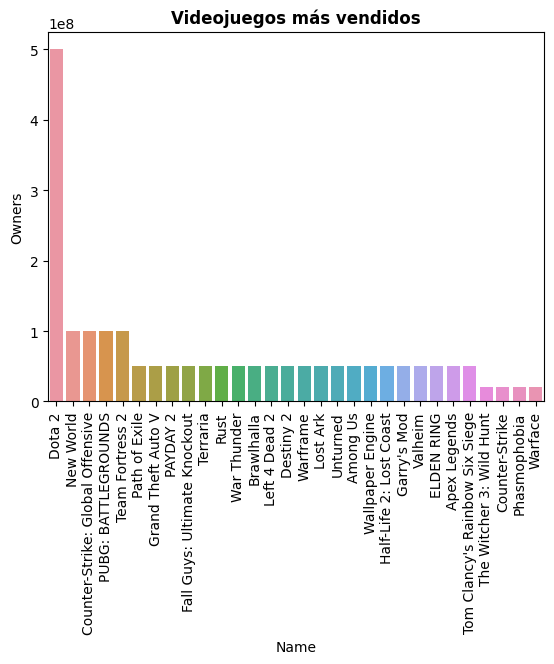

In [6]:
# Se realiza grafico por medio de la librería Seaborn que corresponde a un diagrama de barras
DataSetGames1=DataSet[["Name","Owners"]].set_index('Name')
DataSetSort5=DataSetGames1.sort_values(["Owners"], ascending=False)
sns.barplot(data=DataSetSort5.head(30),x=DataSetSort5.head(30).index,y=DataSetSort5["Owners"].head(30))#y=ha["Owners"].head(30)
plt.xticks(rotation=90)
plt.title('Videojuegos más vendidos', size=12, fontweight="bold")

<FONT SIZE=5><a name="Conclu1"><p style="color:#EC5D01"><b>Conclusión 1</p></a></FONT>
<p  style="text-align: justify"><b>
El diagrama de barras pretende mostrar cual es el videojuego más vendido, según el grafico el videojuego mas vendido es DOTA2 , seguido en un rango menor por  New World y Counter-Strike: Global Offensive
</p>
<a href="#11"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/ConclusionesV2.png" alt="" style="width:150px;height:150px;"></a>


Text(0.5, 1.0, 'Fechas de lanzamiento por Video Juego')

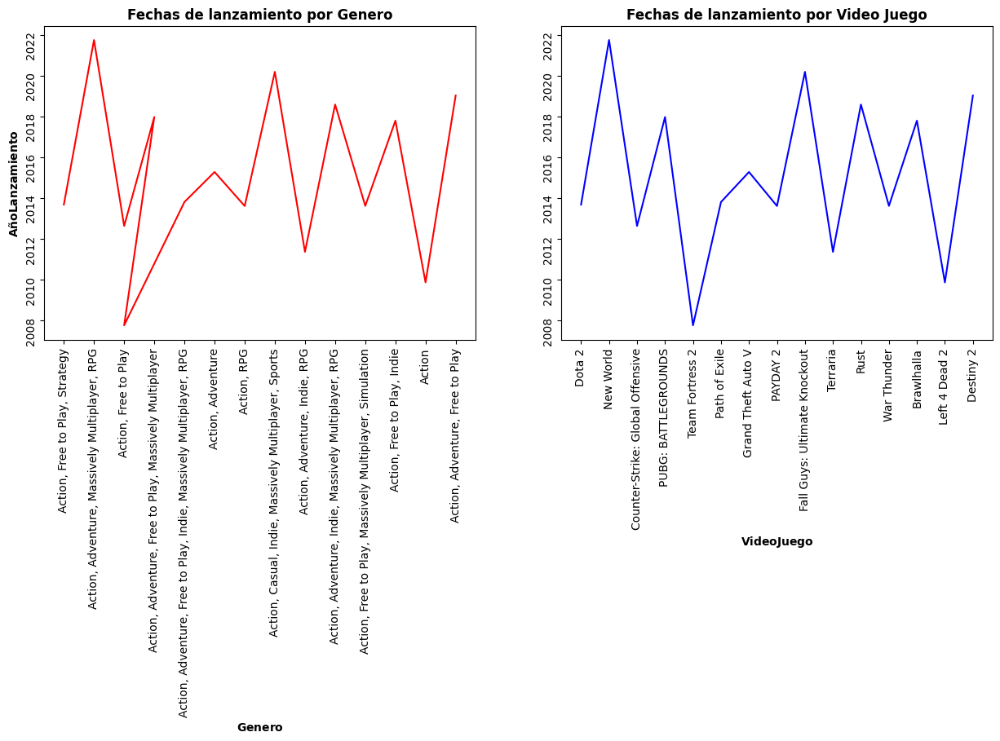

In [7]:
# Se realiza grafico por medio de la librería Matplotlib que corresponde a dos series temporales
DataSetGames = DataSet[["Name", "Owners", "Release Date", "Genre"]].set_index("Name")
DataSetSort4 = DataSetGames.sort_values(["Owners"], ascending=False)

f, (at, at1) = plt.subplots(
    nrows=1, ncols=2, figsize=(15, 5)
)  # sharex=True, sharey=True
at.plot(DataSetSort4["Genre"].head(15), DataSetSort4["Release Date"].head(15), color="r")
at.set_xlabel(r"$\mathbf{Genero}$")
at.set_ylabel(r"$\mathbf{Año Lanzamiento}$")
at.tick_params(labelrotation=90)
at.set_title("Fechas de lanzamiento por Genero", size=12, fontweight="bold")
at1.plot(DataSetSort4.head(15).index, DataSetSort4["Release Date"].head(15), color="b")
at1.set_xlabel(r"$\mathbf{Video Juego}$")
at1.tick_params(labelrotation=90)
at1.set_title("Fechas de lanzamiento por Video Juego", size=12, fontweight="bold")

<FONT SIZE=5><a name="Conclu2"><p style="color:#EC5D01"><b>Conclusión 2</p></a></FONT>
<p  style="text-align: justify"><b>
Los gráficos de series temporales pretender mostrar en que años se tuvieron mayores ventas con respeto a videojuegos y a géneros de videojuegos, según los gráficos la mayoría de los picos se pueden encontrar en un rango del 2018 y 2020, evidenciando un rango generacional de los compradores preponderante. 
</p>
<a href="#11"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/ConclusionesV2.png" alt="" style="width:150px;height:150px;"></a>

Text(0.5, 1.0, 'Desarrollador con más reseñas negativas')

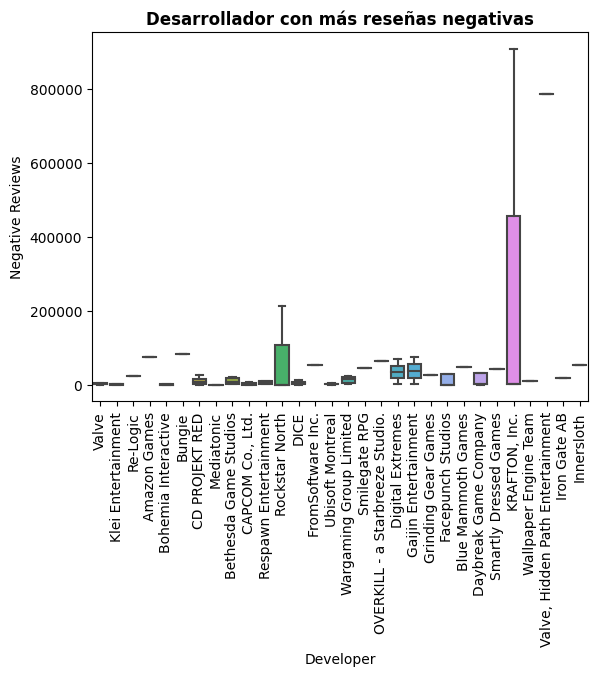

In [8]:
# Se realiza grafico por medio de la librería Seaborn que corresponde un Diagrama de caja
sns.boxplot(x="Developer", y="Negative Reviews", data=DataSetFilter01, showfliers=False)
plt.xticks(rotation=90)
plt.title('Desarrollador con más reseñas negativas', size=12, fontweight="bold")

<p  style="text-align: justify"><b>
El diagrama de cajas y bigotes pretende mostrar cuales son los desarrolladores que han recibido más reseñas negativas y cuáles son sus porcentajes aproximados, según el grafico el desarrollador con mas reseñas negativas es KRAFTON, Inc., en un rango del 75% Q3 de 500000 reseñas negativas y un 100% Q4 de 900000 reseñas negativas, seguido por Valve, Hidden Path Entertainment con un valor atípico entre las 800000 reseñas negativas y Rockstar North en un rango del 75% Q3 de 100000 reseñas negativas y un 100% Q4 de 200000 reseñas negativas.
</p>

Text(0.5, 1.0, 'Géneros de videojuegos más utilizado por los desarrolladores')

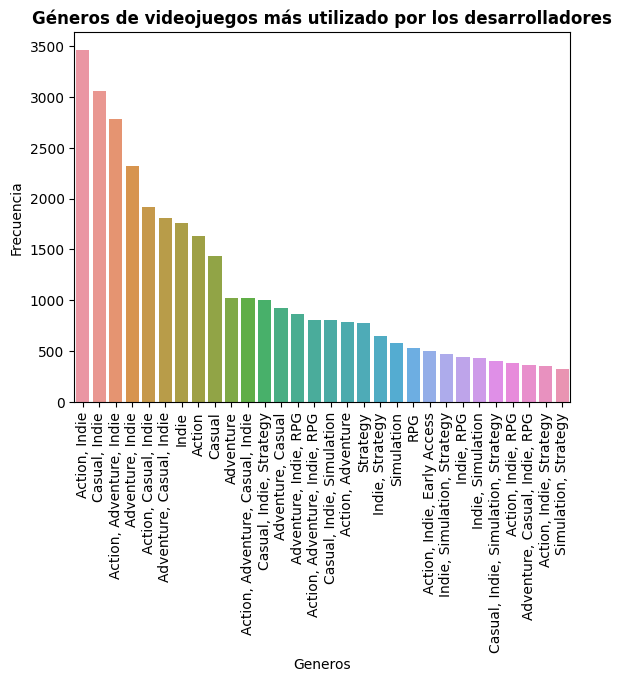

In [9]:
# Se realiza grafico por medio de la librería Seaborn que corresponde a un diagrama de barras
sns.barplot(x=DataSet["Genre"].value_counts().head(30).index,y=DataSet["Genre"].value_counts().head(30).values)
plt.xticks(rotation=90)
plt.xlabel('Generos')
plt.ylabel('Frecuencia')
plt.title('Géneros de videojuegos más utilizado por los desarrolladores', size=12, fontweight="bold")

In [10]:
DataSet["Genre"].value_counts().head(30).values

array([3460, 3060, 2783, 2316, 1914, 1811, 1756, 1633, 1433, 1021, 1018,
       1000,  928,  867,  807,  801,  784,  779,  647,  579,  534,  498,
        470,  444,  434,  407,  379,  360,  356,  323], dtype=int64)

<p  style="text-align: justify"><b>
El diagrama de barras pretende mostrar cual es el género más utilizado por los desarrolladores para crear los videojuegos, según el grafico el videojuego más usado es el (Action, Indie), seguido por el (Casual, Indie) y el (Action, Adventure, indie)
</p>

Text(0.5, 1.0, 'Desarrolladores con mas titulos de videojuegos publicados en Steam')

C:\Users\jlope\AppData\Roaming\Python\Python310\site-packages\IPython\core\events.py:89: UserWarning:

Glyph 142 (\x8e) missing from current font.

C:\Users\jlope\AppData\Roaming\Python\Python310\site-packages\IPython\core\events.py:89: UserWarning:

Glyph 145 (\x91) missing from current font.

C:\Users\jlope\AppData\Roaming\Python\Python310\site-packages\IPython\core\events.py:89: UserWarning:

Glyph 156 (\x9c) missing from current font.

C:\Users\jlope\AppData\Roaming\Python\Python310\site-packages\IPython\core\pylabtools.py:151: UserWarning:

Glyph 142 (\x8e) missing from current font.

C:\Users\jlope\AppData\Roaming\Python\Python310\site-packages\IPython\core\pylabtools.py:151: UserWarning:

Glyph 145 (\x91) missing from current font.

C:\Users\jlope\AppData\Roaming\Python\Python310\site-packages\IPython\core\pylabtools.py:151: UserWarning:

Glyph 156 (\x9c) missing from current font.



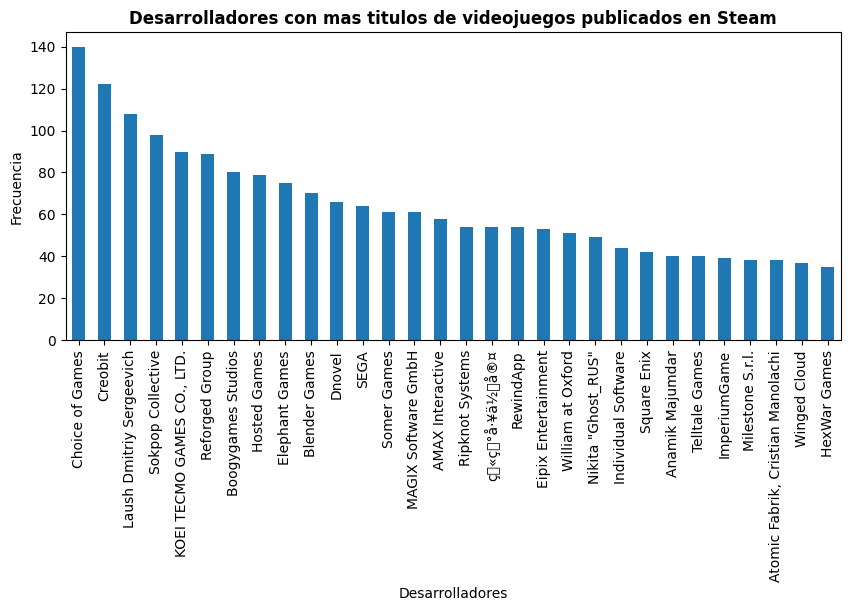

In [11]:
# Se realiza grafico por medio de la librería  Matplotlib que corresponde a un diagrama de barras
DataSet["Developer"].value_counts()[0:30].plot(
    kind="bar",
    figsize=(10, 4),
    xlabel="Desarrolladores",
    ylabel="Frecuencia",
    #title="Desarrolladores con mas titulos de videojuegos publicados en Steam",
)
plt.title("Desarrolladores con mas titulos de videojuegos publicados en Steam", size=12, fontweight="bold")


<p  style="text-align: justify"><b>
El diagrama de barras pretende mostrar cual es el desarrollador que posee más títulos publicados en la plataforma Steam, según el grafico los desarrolladores que más poseen títulos en esta plataforma son Choise of games con más de 130 títulos, Creobit con mas de 120 y Laush Dmitriy Sergeevich con mas de 100 títulos.
</p>

(array([], dtype=float64), [])

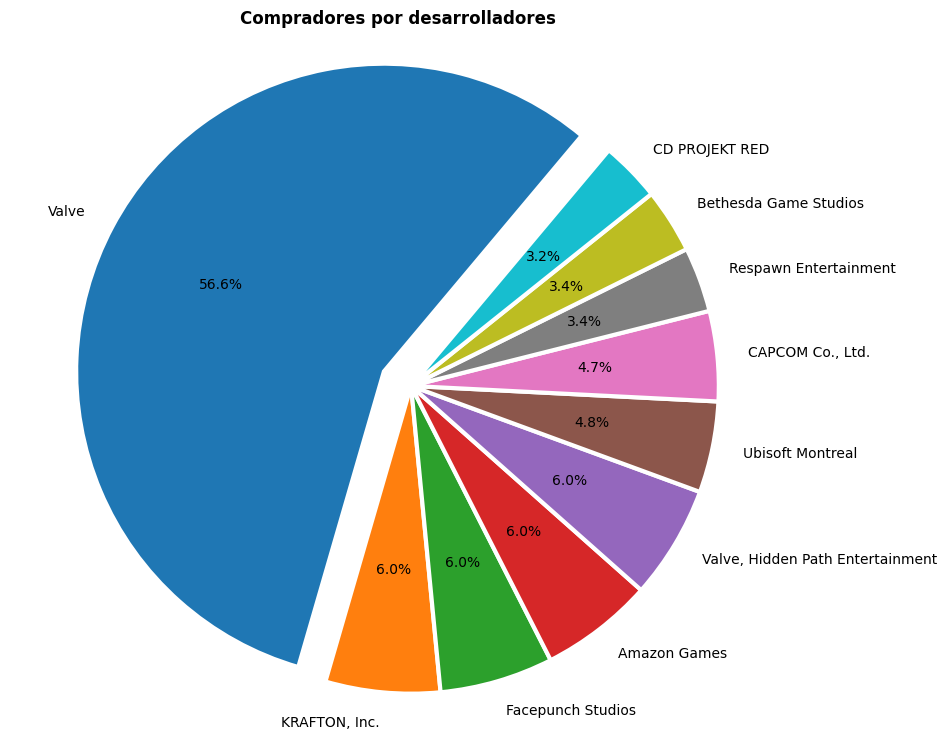

In [12]:
# Se realiza grafico por medio de la librería Matplotlib que corresponde a un diagrama de torta
fig, ax = plt.subplots(figsize=(10, 9))
explode = (0.1,0,0,0,0,0,0,0,0,0)
ax.pie(
    DataSetSort0["Owners"].iloc[:10],
    explode=explode,
    labels=DataSetSort0.iloc[:10].index,
    autopct='%1.1f%%',
    #autopct="%0.1f %%",
    wedgeprops={'linewidth' : 3, 'edgecolor' : 'white'},
    startangle=50,
)
plt.axis('equal') 
plt.title("Compradores por desarrolladores", size=12, fontweight="bold")
plt.xticks(rotation=90)

<FONT SIZE=5><a name="Conclu3"><p style="color:#EC5D01"><b>Conclusión 3</p></a></FONT>
<p  style="text-align: justify"><b>
El grafico de torta pretende mostrar el porcentaje de compradores con respecto a los desarrolladores de los videojuegos, según el grafico el desarrollador con más compradores es Valve Corporation con el 56.6%, seguido de manera distante por KRAFTON con 6%, Inc. y Amazon Games 6%
</p>
<a href="#11"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/ConclusionesV2.png" alt="" style="width:150px;height:150px;"></a>

Text(0.5, 1.0, 'Concurrent Steam Users por géneros ')

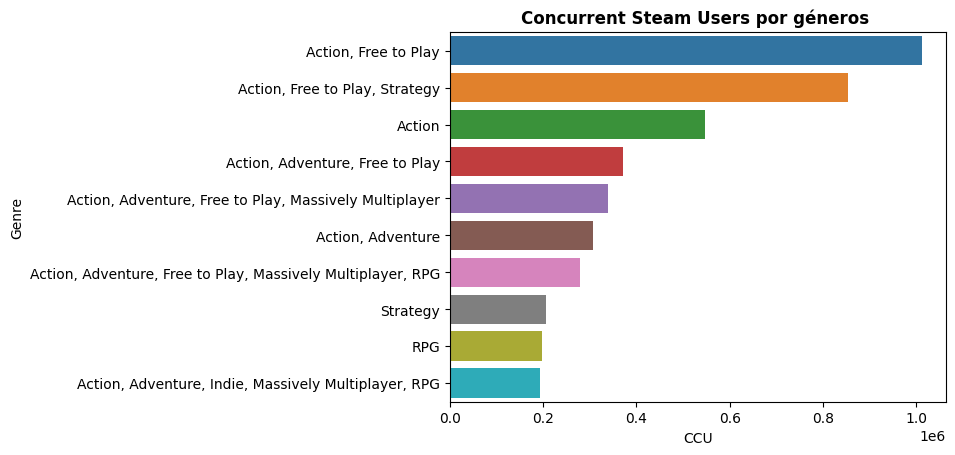

In [13]:
# Se realiza grafico por medio de la librería SeaBorn, este corresponde a un histograma
sns.barplot(data=DataSetSort14.head(10), x="CCU", y=DataSetSort14.head(10).index)
plt.title("Concurrent Steam Users por géneros ", size=12, fontweight="bold")

<FONT SIZE=5><a name="Conclu4"><p style="color:#EC5D01"><b>Conclusión 4</p></a></FONT>
<p  style="text-align: justify"><b>El Histograma pretende mostrar la variable Concurrent Steam Users con respecto al género del video juego, según el grafico la mayor concurrencia de usuarios Steam (CCU) se da en el género Action, Free to Play seguido por el género Action, Free to Play, Strategy</p>
<a href="#11"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/ConclusionesV2.png" alt="" style="width:150px;height:150px;"></a>

In [14]:
# ---------------------------------Librerias para guardar plotly como png----------------------
# import plotly.offline as pyo
# from plotly import subplots
# import plotly.express as px
# import plotly.io as pio
# import plotly.graph_objects as go
# import kaleido # install kaleido==0.1.0post1 or # pip install --upgrade "kaleido==0.1.*"
# pio.renderers.default = "notebook" # render pio y kaleido

C:\Users\jlope\AppData\Local\Temp\ipykernel_15232\10642245.py:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



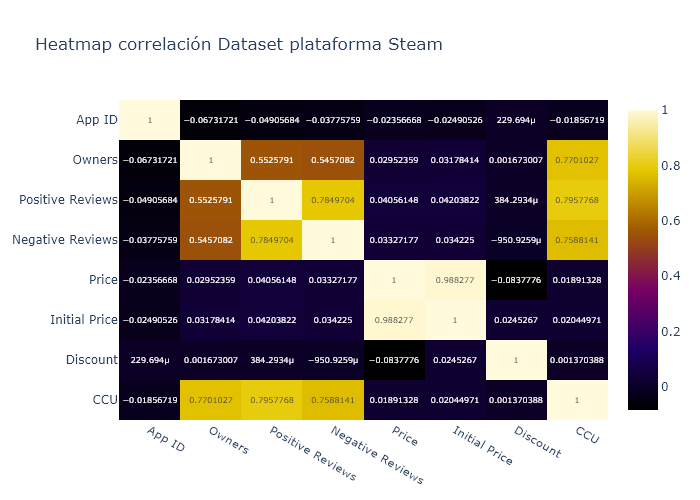

In [15]:
#------------------plotly-----------------------------
fig =  go.Figure(px.imshow(DataSet.corr(method='pearson'),text_auto=True, aspect="auto",color_continuous_scale='Electric',title='Heatmap correlación Dataset plataforma Steam'))
fig.show()
fig.show("png")
#----------------SeaBorn------------------------------
# corr_df = DataSet.corr(method='pearson')
# plt.figure(figsize=(15, 6))
# sns.heatmap(corr_df, annot=True)
# plt.show()

<p  style="text-align: justify"><b>El heatmap muestra la correlación entre las variables numéricas del DataSet de la plataforma de videojuegos Steam, se puede observar una correlación muy alta entre las variables Owners, Positive Reviews, Negative Reviews, CCU, lo que evidencia que tanto la concurrencia de jugadores como los compradores se ven muy afectados con respecto a las reseñas positivas y negativas.</p>

<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><a name="6"><h2><b>API´s complemento EDA</h2></a></th>
        <th style="border-style: none;"><a href="#menu"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/FlechaUpV2.png" alt="" style="width:70px;height:70px;"></a></th>       
    </tr>
</table>


<p  style="text-align: justify"><b>La API usada a continuación es tomada del sitio web https://rawg.io/, una base de datos actualizada de videojuegos, las dos consultas a la API que se realizan son la cantidad de videojuegos por plataforma y por tienda, esto se realizada con la idea de efectuar una comparación global y de reforzar la importancia de la plataforma de videojuegos Steam y los videojuegos de PC.</p>

In [55]:
# Se lee un archivo .txt donde se encuentra el key privado de la API
with open("Notas_Ignore/pass.txt",'r') as f:
    pwd= f.read()
# Se lee el API, se genera el requests y se descargan los datos de la API
url1 = "https://api.rawg.io/api/platforms?key="+pwd
headers1 = {"Accept-Encoding": "gzip, deflate"}
response1 = requests.get(url1, headers=headers1)
data1 = response1.json()

url2 = "https://api.rawg.io/api/stores?key="+pwd
headers2 = {"Accept-Encoding": "gzip, deflate"}
response2 = requests.get(url2, headers=headers1)
data2 = response2.json()
# Se imprime la respuesta y la data
print(response1)
print(response2)
#print(data1)
#print(data2)

#Se convierten los datos json en DataFrame
#------------------------------------------------
DataSetApi1= pd.DataFrame(data1['results'])
#DataSetApi1.to_csv('DataSetApi1.csv')
#------------------------------------------------
DataSetApi2= pd.DataFrame(data2['results'])
#DataSetApi2.to_csv('DataSetApi2.csv')
df_mask=DataSetApi2['name']!="itch.io"
filtered_df = DataSetApi2[df_mask]

<Response [200]>
<Response [200]>


In [49]:
# Se imprimen las Keys
print(data1.keys())
print(data2.keys())

dict_keys(['count', 'next', 'previous', 'results'])
dict_keys(['count', 'next', 'previous', 'results'])


In [50]:
#Se imprime el DataSet de las plataformas 
DataSetApi1.head(5)

,id,name,slug,games_count,image_background,image,year_start,year_end,games
0,4,PC,pc,513214,https://media.rawg.io/media/games/021/021c4e21...,None,NaN,None,"[{'id': 3498, 'slug': 'grand-theft-auto-v', 'n..."
1,187,PlayStation 5,playstation5,884,https://media.rawg.io/media/games/5ec/5ecac5cb...,None,2020.0,None,"[{'id': 3498, 'slug': 'grand-theft-auto-v', 'n..."
2,1,Xbox One,xbox-one,5514,https://media.rawg.io/media/games/960/960b601d...,None,NaN,None,"[{'id': 3498, 'slug': 'grand-theft-auto-v', 'n..."
3,18,PlayStation 4,playstation4,6638,https://media.rawg.io/media/games/d82/d82990b9...,None,NaN,None,"[{'id': 3498, 'slug': 'grand-theft-auto-v', 'n..."
4,186,Xbox Series S/X,xbox-series-x,764,https://media.rawg.io/media/games/5eb/5eb49eb2...,None,2020.0,None,"[{'id': 3498, 'slug': 'grand-theft-auto-v', 'n..."


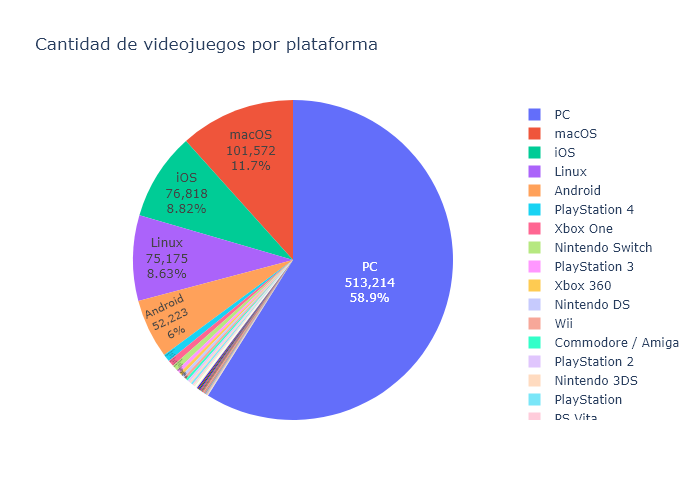

In [19]:
# Se genera un grafico de torta con la libreria Plotly
fig = px.pie(DataSetApi1, values='games_count', names='name',title='Cantidad de videojuegos por plataforma')
fig.update_traces(textposition='inside', textinfo='value+percent+label')
fig.show()
fig.show("png")

<p style="text-align: justify"><b>El grafico de torta pretende mostrar el porcentaje de videojuegos por plataforma, el grafico evidencia que la plataforma PC contiene una cantidad significativa de videojuegos tomando como valor el 58% en comparación a las otras plataformas.</p>

In [56]:
#Se imprime el DataSet de las tiendas
#DataSetApi2.drop([8], axis=0, inplace=True)#Borrar dato desfasado
#DataSetApi2
filtered_df.head(10)

,id,name,domain,slug,games_count,image_background,games
0,1,Steam,store.steampowered.com,steam,76077,https://media.rawg.io/media/games/f87/f87457e8...,"[{'id': 3498, 'slug': 'grand-theft-auto-v', 'n..."
1,3,PlayStation Store,store.playstation.com,playstation-store,7818,https://media.rawg.io/media/games/b72/b7233d5d...,"[{'id': 3498, 'slug': 'grand-theft-auto-v', 'n..."
2,2,Xbox Store,microsoft.com,xbox-store,4760,https://media.rawg.io/media/games/f87/f87457e8...,"[{'id': 3498, 'slug': 'grand-theft-auto-v', 'n..."
3,4,App Store,apps.apple.com,apple-appstore,75054,https://media.rawg.io/media/games/13a/13a528ac...,"[{'id': 5286, 'slug': 'tomb-raider', 'name': '..."
4,5,GOG,gog.com,gog,5203,https://media.rawg.io/media/games/ee3/ee3e1019...,"[{'id': 3328, 'slug': 'the-witcher-3-wild-hunt..."
5,6,Nintendo Store,nintendo.com,nintendo,8874,https://media.rawg.io/media/games/c4b/c4b0cab1...,"[{'id': 3328, 'slug': 'the-witcher-3-wild-hunt..."
6,7,Xbox 360 Store,marketplace.xbox.com,xbox360,1912,https://media.rawg.io/media/games/456/456dea5e...,"[{'id': 3498, 'slug': 'grand-theft-auto-v', 'n..."
7,8,Google Play,play.google.com,google-play,17040,https://media.rawg.io/media/games/713/71326960...,"[{'id': 5286, 'slug': 'tomb-raider', 'name': '..."
9,11,Epic Games,epicgames.com,epic-games,1243,https://media.rawg.io/media/games/b7d/b7d3f171...,"[{'id': 3498, 'slug': 'grand-theft-auto-v', 'n..."


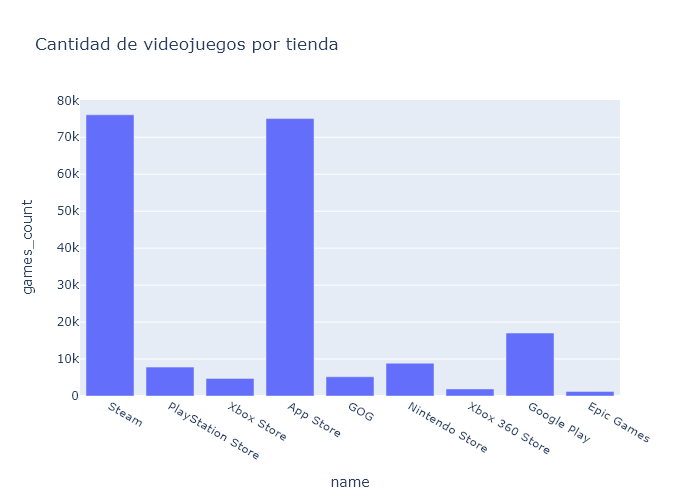

In [58]:
fig = px.bar(filtered_df, x='name', y='games_count', title='Cantidad de videojuegos por tienda')
fig.show()
fig.show("png")

<p  style="text-align: justify"><b>El grafico de barras pretende mostrar la cantidad de videojuegos por tienda, el grafico evidencia que la tienda Steam contiene una cantidad significativa de videojuegos, superando en gran medida a las otras tiendas.</p>


<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><a name="7"><h2><b>Data Wrangling</h2></a></th>
        <th style="border-style: none;"><a href="#menu"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/FlechaUpV2.png" alt="" style="width:70px;height:70px;"></a></th>       
    </tr>
</table>

In [22]:
DataSetClean = DataSet.copy()
DataSetClean["Categories"] = DataSetClean["Categories"].astype(str)
DataSetClean["Genre"] = DataSetClean["Genre"].astype(str)
DataSetClean["Languages"] = DataSetClean["Languages"].astype(str)
DataSetClean["Platforms"] = DataSetClean["Platforms"].astype(str)
DataSetClean['NewCategories']=DataSetClean['Categories'].apply(lambda x: re.sub("(\\,.*)", "", x))
DataSetClean['NewGenre']=DataSetClean['Genre'].apply(lambda x: re.sub("(\\,.*)", "", x))
DataSetClean['NewLanguages']=DataSetClean['Languages'].apply(lambda x: re.sub("(\\,.*)", "", x))
DataSetClean['NewPlatforms']=DataSetClean['Platforms'].apply(lambda x: re.sub("(\\,.*)", "", x))
DataSetClean.drop(['Platforms','Languages','Genre','App ID', 'Short Description','Tags','Initial Price','Discount','Required Age','Website','Header Image','Categories','Type','Publisher'], axis=1, inplace=True)
modaGenre = DataSetClean["NewGenre"].mode()[0]
#DataSetClean["NewGenre"].replace(to_replace = "nan", value = modaGenre,inplace=True)
DataSetClean["NewGenre"].replace(to_replace = ["Casual","nan"], value = modaGenre,inplace=True)
modaCategoria = "Multi-player"
DataSetClean["NewCategories"].replace(to_replace = ["Steam Cloud","Steam Achievements","nan"], value = modaCategoria,inplace=True)
DataSetClean.head(100)
print(DataSetClean.shape)

(55691, 12)


In [23]:
DataSetClean.isnull().sum()

Name                  0
Developer           129
Owners                0
Positive Reviews      0
Negative Reviews      0
Price                 0
CCU                   0
Release Date         99
NewCategories         0
NewGenre              0
NewLanguages          0
NewPlatforms          0
dtype: int64

In [24]:
#Tratar Nulos
#moda_language = DataSetClean["Languages"].mode()[0]
date_string = '0001-01-01'
nueva_fecha = datetime.strptime(date_string, '%Y-%m-%d').date()
nueva_fecha = nueva_fecha.strftime("%Y-%m-%d")
#DataSetClean["Languages"].fillna(moda_language,inplace=True)
DataSetClean.fillna({'Release Date': nueva_fecha,'Developer': "Unknown"},inplace=True)

In [25]:
DataSetClean.isnull().sum()

Name                0
Developer           0
Owners              0
Positive Reviews    0
Negative Reviews    0
Price               0
CCU                 0
Release Date        0
NewCategories       0
NewGenre            0
NewLanguages        0
NewPlatforms        0
dtype: int64

In [26]:
#Tratar Duplicados
DataSetClean[DataSetClean.duplicated()]

,Name,Developer,Owners,Positive Reviews,Negative Reviews,Price,CCU,Release Date,NewCategories,NewGenre,NewLanguages,NewPlatforms


<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><a name="8"><h2><b>Entrenamiento y Testeo (Machine Learning)</h2></a></th>
        <th style="border-style: none;"><a href="#menu"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/FlechaUpV2.png" alt="" style="width:70px;height:70px;"></a></th>       
    </tr>
</table>

In [27]:
X=DataSetClean[['NewGenre','Positive Reviews','Price','CCU','NewCategories','NewPlatforms']]
y= DataSetClean['Owners'].astype('str')

In [28]:
y

0        20000000
1           20000
2          500000
3          200000
4           20000
           ...   
55686       20000
55687       20000
55688       50000
55689       20000
55690       20000
Name: Owners, Length: 55691, dtype: object

In [29]:
X

,NewGenre,Positive Reviews,Price,CCU,NewCategories,NewPlatforms
0,Action,201215,999,13990,Multi-player,windows
1,Action,27,999,0,Single-player,windows
2,Adventure,4032,599,99,Single-player,windows
3,Action,1575,1999,76,Multi-player,windows
4,Action,0,199,0,Single-player,windows
...,...,...,...,...,...,...
55686,Education,12,0,0,Multi-player,windows
55687,Adventure,2,299,0,Single-player,windows
55688,Animation & Modeling,12,0,0,Multi-player,windows
55689,Indie,2,499,0,Single-player,windows


<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><a name="9"><h2><b>Random Forest: Bosque aleatorio</h2></a></th>
        <th style="border-style: none;"><a href="#menu"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/FlechaUpV2.png" alt="" style="width:70px;height:70px;"></a></th>       
    </tr>
</table>

In [30]:
# Codifica variables
A=X[['Positive Reviews','Price','CCU']] # Numericas
B=pd.get_dummies(X[['NewGenre','NewCategories','NewPlatforms']], drop_first=True) # Binarias
X_new=pd.concat([A,B],axis=1)
X_new.head()

,Positive Reviews,Price,CCU,NewGenre_Action,NewGenre_Adventure,NewGenre_Animation & Modeling,NewGenre_Audio Production,NewGenre_Design & Illustration,NewGenre_Early Access,NewGenre_Education,NewGenre_Free to Play,NewGenre_Game Development,NewGenre_Gore,NewGenre_Indie,NewGenre_Massively Multiplayer,NewGenre_Nudity,NewGenre_Photo Editing,NewGenre_RPG,NewGenre_Racing,NewGenre_Sexual Content,NewGenre_Simulation,NewGenre_Software Training,NewGenre_Sports,NewGenre_Strategy,NewGenre_Utilities,NewGenre_Video Production,NewGenre_Violent,NewGenre_Web Publishing,NewCategories_Co-op,NewCategories_Commentary available,NewCategories_Cross-Platform Multiplayer,NewCategories_Full controller support,NewCategories_In-App Purchases,NewCategories_Includes Source SDK,NewCategories_Includes level editor,NewCategories_MMO,NewCategories_Multi-player,NewCategories_Online PvP,NewCategories_Partial Controller Support,NewCategories_Remote Play Together,NewCategories_Single-player,NewCategories_Stats,NewCategories_Steam Leaderboards,NewCategories_Steam Trading Cards,NewCategories_Steam Workshop,NewCategories_VR Support,NewPlatforms_mac,NewPlatforms_windows
0,201215,999,13990,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1
1,27,999,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1
2,4032,599,99,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1
3,1575,1999,76,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1
4,0,199,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1


In [31]:
X_train, X_test, y_train, y_test = train_test_split(X_new, y, test_size=0.60, random_state=42)

In [32]:
#clf = RandomForestClassifier(max_depth = 8, random_state = 42,criterion='gini')
clf = RandomForestClassifier(max_depth=10, random_state=42, n_estimators=100,criterion='gini')
clf.fit(X_train, y_train)

RandomForestClassifier(max_depth=10, random_state=42)

In [33]:
# Obtener predicciones
y_pred= clf.predict(X_test)

In [34]:
print(classification_report(y_pred=y_pred, y_true= y_test))

c:\Users\jlope\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

c:\Users\jlope\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



              precision    recall  f1-score   support

      100000       0.32      0.10      0.16      2251
     1000000       0.35      0.22      0.27       570
    10000000       0.50      0.02      0.03        60
   100000000       0.00      0.00      0.00         4
       20000       0.79      0.99      0.88     22713
      200000       0.31      0.17      0.22      1506
     2000000       0.38      0.20      0.27       318
    20000000       0.17      0.04      0.07        24
       50000       0.37      0.10      0.15      4413
      500000       0.41      0.51      0.45      1329
     5000000       0.47      0.25      0.33       216
    50000000       0.25      0.09      0.13        11

    accuracy                           0.73     33415
   macro avg       0.36      0.22      0.25     33415
weighted avg       0.65      0.73      0.67     33415



c:\Users\jlope\AppData\Local\Programs\Python\Python310\lib\site-packages\sklearn\metrics\_classification.py:1344: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [35]:
clf.feature_importances_

array([6.07664125e-01, 7.52194496e-02, 2.60773563e-01, 3.64519667e-03,
       2.71527044e-03, 1.44983102e-03, 8.47069579e-04, 4.63878220e-04,
       1.29397390e-04, 5.22352202e-04, 8.08615689e-03, 7.10024217e-06,
       4.00004765e-04, 2.34916218e-03, 4.98724032e-04, 1.05934725e-04,
       1.83611868e-05, 2.80750842e-03, 1.03881187e-03, 3.92000269e-04,
       1.60214307e-03, 1.58013527e-04, 5.30273835e-04, 3.78972854e-03,
       1.18046344e-03, 3.05245675e-04, 4.16190379e-04, 7.52287279e-05,
       4.42924403e-04, 0.00000000e+00, 0.00000000e+00, 1.01356192e-04,
       2.10588317e-04, 0.00000000e+00, 2.54831504e-04, 2.48264678e-04,
       9.74792301e-03, 0.00000000e+00, 5.10971210e-04, 3.29806531e-07,
       9.64152692e-03, 2.57928661e-04, 1.94539988e-04, 1.61322545e-04,
       3.83130161e-04, 1.32463868e-04, 2.48462068e-04, 2.72251616e-04])

In [36]:
len(clf.feature_importances_)

48

In [37]:
len(X_train.columns)

48

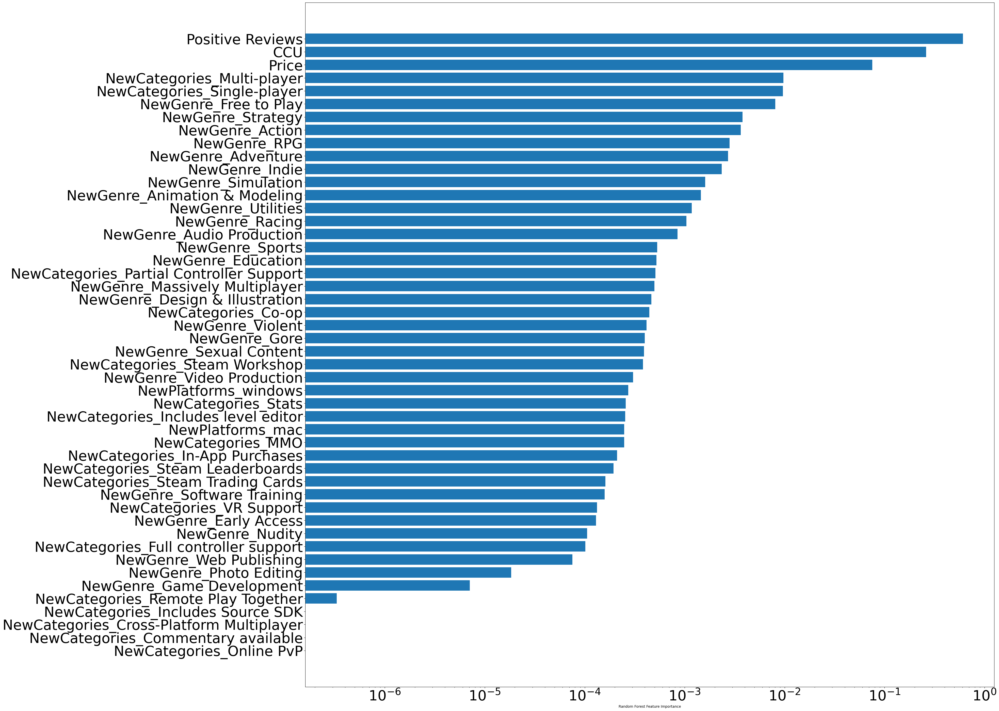

In [38]:
sorted_idx = clf.feature_importances_.argsort()
fig, ax = plt.subplots()
plt.barh(X_train.columns[sorted_idx], clf.feature_importances_[sorted_idx], log=True)
plt.xlabel("Random Forest Feature Importance")
#plt.rcParams.update({'font.size': 5})
plt.tick_params(labelsize=40)
#plt.rcParams['font.size'] = 30
width = 35
height = 35
fig.set_size_inches(width, height)


<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><a name="10"><h2><b>Regresión lineal</h2></a></th>
        <th style="border-style: none;"><a href="#menu"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/FlechaUpV2.png" alt="" style="width:70px;height:70px;"></a></th>       
    </tr>
</table> 

In [39]:
NewCategoriesFilter = DataSetClean.NewCategories.value_counts().iloc[0:7]
NewGenreFilter = DataSetClean.NewGenre.value_counts().iloc[0:7]
NewGenreList = NewGenreFilter.index.tolist()
NewCategoriesList = NewCategoriesFilter.index.tolist()
NewGenreSelection = DataSetClean["NewGenre"].isin(NewGenreList)
NewCategoriesSelection = DataSetClean["NewCategories"].isin(NewCategoriesList)
DataSetClean = DataSetClean[NewGenreSelection]
DataSetClean = DataSetClean[NewCategoriesSelection]
DataSetClean


C:\Users\jlope\AppData\Local\Temp\ipykernel_15232\3829707662.py:8: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



,Name,Developer,Owners,Positive Reviews,Negative Reviews,Price,CCU,Release Date,NewCategories,NewGenre,NewLanguages,NewPlatforms
0,Counter-Strike,Valve,20000000,201215,5199,999,13990,2000-01-11 00:00:00,Multi-player,Action,English,windows
1,ASCENXION,IndigoBlue Game Studio,20000,27,5,999,0,2021-05-14 00:00:00,Single-player,Action,English,windows
2,Crown Trick,NEXT Studios,500000,4032,646,599,99,2020-10-16 00:00:00,Single-player,Adventure,Simplified Chinese,windows
3,"Cook, Serve, Delicious! 3?!",Vertigo Gaming Inc.,200000,1575,115,1999,76,2020-10-14 00:00:00,Multi-player,Action,English,windows
4,ç»èæäº,DoubleC Games,20000,0,1,199,0,2019-03-30 00:00:00,Single-player,Action,Simplified Chinese,windows
...,...,...,...,...,...,...,...,...,...,...,...,...
55683,Becalm,Colorfiction,100000,284,51,0,0,2019-01-17 00:00:00,Single-player,Action,English,windows
55685,Enemy On Board,Windwalk Games,200000,1146,423,0,0,2020-08-05 00:00:00,Multi-player,Action,English,windows
55687,Bruken,FlairBot Games,20000,2,0,299,0,2019-11-04 00:00:00,Single-player,Adventure,English,windows
55689,Fantasy Sino-Japanese War å¹»æ³ç²å,å¼ å «ä¸å·¥ä½å®¤,20000,2,2,499,0,2019-11-01 00:00:00,Single-player,Indie,English,windows


In [40]:
# Dummys
dumms = ['NewGenre','NewCategories','NewPlatforms']
DataSetCleanR = pd.get_dummies(data = DataSetClean,
               columns = dumms,
               drop_first =True,
              dtype='int8')

DataSetCleanR .drop(['Name', 'Developer', 'Release Date','Release Date','NewLanguages'], axis=1,inplace=True)
DataSetCleanR 

,Owners,Positive Reviews,Negative Reviews,Price,CCU,NewGenre_Adventure,NewGenre_Free to Play,NewGenre_Indie,NewGenre_RPG,NewGenre_Simulation,NewGenre_Strategy,NewCategories_In-App Purchases,NewCategories_Includes level editor,NewCategories_Multi-player,NewCategories_Partial Controller Support,NewCategories_Single-player,NewCategories_Steam Workshop,NewPlatforms_mac,NewPlatforms_windows
0,20000000,201215,5199,999,13990,0,0,0,0,0,0,0,0,1,0,0,0,0,1
1,20000,27,5,999,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1
2,500000,4032,646,599,99,1,0,0,0,0,0,0,0,0,0,1,0,0,1
3,200000,1575,115,1999,76,0,0,0,0,0,0,0,0,1,0,0,0,0,1
4,20000,0,1,199,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55683,100000,284,51,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1
55685,200000,1146,423,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1
55687,20000,2,0,299,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1
55689,20000,2,2,499,0,0,0,1,0,0,0,0,0,0,0,1,0,0,1


In [41]:
#DataSetCleanR ['Owners'] = np.log(DataSetCleanR['Owners'])
X = DataSetCleanR .drop('Owners',axis=1) # Independet variable
y = DataSetCleanR ['Owners'] # dependent variable
x = sm.add_constant(X)
model = sm.OLS(y, x).fit()
pred = model.predict(x) 
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                 Owners   R-squared:                       0.606
Model:                            OLS   Adj. R-squared:                  0.606
Method:                 Least Squares   F-statistic:                     4600.
Date:                Mon, 12 Jun 2023   Prob (F-statistic):               0.00
Time:                        13:02:27   Log-Likelihood:            -8.4655e+05
No. Observations:               53770   AIC:                         1.693e+06
Df Residuals:                   53751   BIC:                         1.693e+06
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                                               coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------

<table style="border-style: none; height:0px;"><b>
    <tr style="border-style: none; height:0px;">
        <th style="border-style: none;"><a name="11"><h2><b>Conclusiones</h2></a></th>
        <th style="border-style: none;"><a href="#menu"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/FlechaUpV2.png" alt="" style="width:70px;height:70px;"></a></th>       
    </tr>
</table>

<ol>
  <li><b>Respondiendo a la pregunta problema: ¿Qué características debe tener en cuenta un desarrollador para crear un videojuego exitoso para ser distribuido en la plataforma Steam?</b>
  <br> <br/>
  <ul  TYPE="square">
            <li><b>Resultados del EDA:</b>
             <ul TYPE="disc">
                <li style="text-align: justify">El video juego más vendido en el 2020 fue DOTA 2, un videojuego Free to Play, MOBA, Multijugador, Estrategia, Aventura. Le siguen los videojuegos New World y Counter-Strike: Global Offensive que comparten de igual manera el modo multijugador, el Free to Play, la Estrategia y la Aventura.</li>
                <a href="#Conclu1"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/statisticsV2.png" alt="" style="width:100px;height:100px;"></a>
                <!–  –>
                <li style="text-align: justify">El siguiente resultado fueron las fechas de publicación por géneros y por videojuegos donde se evidencia un rango picos desde el 2018 al 2020, evidenciando un rango generacional de los compradores, decantando nuevamente sobre los videojuegos Free to Play, multijugador y de Estrategia</li>
                <a href="#Conclu2"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/statisticsV2.png" alt="" style="width:100px;height:100px;"></a>
                <!–  –>                
                <li style="text-align: justify">Los resultados en relación a los compradores con respecto a los desarrolladores evidencian que los desarrolladores con más compradores son Valve, KRAFTON y Amazon Games, cuyos juegos también han sido los más vendidos; DOTA, Counter-Strike: Global Offensive, PUBG: BATTLEGROUNDS y New World respectivamente.</li>
                <a href="#Conclu3"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/statisticsV2.png" alt="" style="width:100px;height:100px;"></a>
                <!–  –>    
                <li style="text-align: justify">Los resultados en relación a los Concurrent Steam Users con respecto al género se evidencia que los videojuegos de acción, Free to Play, estrategia y aventura son los que poseen más concurrencia de usuarios.</li>
                <a href="#Conclu4"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/statisticsV2.png" alt="" style="width:100px;height:100px;"></a>
                <!–  –>    
            </ul>
            </li>
            <br> 
            <li><b>Resultados Machine Learning:</b>
             <ul TYPE="disc">
                  <li style="text-align: justify">Los resultados en relación a las predicciones de los algoritmos de Machine Learning, tanto del Random Forest y la Regresión lineal con un accuracy del 0.73 y un R-squared del 0.606 respectivamente arrojan que el género Free to Play, Adventure y Strategy son por los que se debería decantar un nuevo desarrollador, de igual manera por la categoría Multi-player.
                  </li>      
                  <a href="#8"><img src="https://raw.githubusercontent.com/JuanC-Pythonista/Proyecto_Data_Science_Unidad1/main/DataSetBootcamp/statisticsV2.png" alt="" style="width:100px;height:100px;"></a>
                <!–  –>                
            </ul> 
            </li>                       
  </ul>   
  </li>
  <br/>
  <li><b>Respondiendo a las hipótesis:</b>
    <br/>  <br/>
  <ol type="a">
    <li>El éxito de los videojuegos recientes proviene netamente de si su desarrollo fue realizado por una de las grandes empresas creadoras de juegos:</li>
    <p style="text-align: justify">Aunque los videojuegos con mas compradores y concurrencia de usuarios han sido desarrollados por grandes empresas de videojuegos como en el caso de Valve y Amazon Games, también existen excepciones como Krafton que fue consolidado en el 2018 por lo que es una empresa relativamente nueva.</p>
    <li>Los videojuegos Free to Play son los que poseen mayor concurrencia debido a la gratuidad de acceso:</li> 
    <p style="text-align: justify">Aunque los videojuegos Free to Play poseen gran concurrencia de usuarios estos deben compartir otras características como el multi-jugador para atraer mas usuarios.</p>
  </ol>
  </li> 
</ol>